In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from IPython.display import Image
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', 50)

In [103]:
df = pd.read_csv('../checkpoint-2/train_test/enriched_data.csv')

data = gpd.GeoDataFrame(
    df.loc[:, [c for c in df.columns if c != 'geometry']],
    geometry = gpd.GeoSeries.from_wkt(df['geometry']),
    crs = 'EPSG:4326'
)

Еще раз взглянем на географическое распределения банкоматов. Раскрасим точки в соответствии с значением `target`
**черные точки – тестовые данные*

In [108]:
data.explore(column='target', cmap='RdYlGn', popup=True)

In [104]:
# Полигоны регионов
regions = gpd.read_file('regions.csv')
# Присоединяем имя региона к основному набору данных
data = data.sjoin(regions).drop('WKT', axis=1)

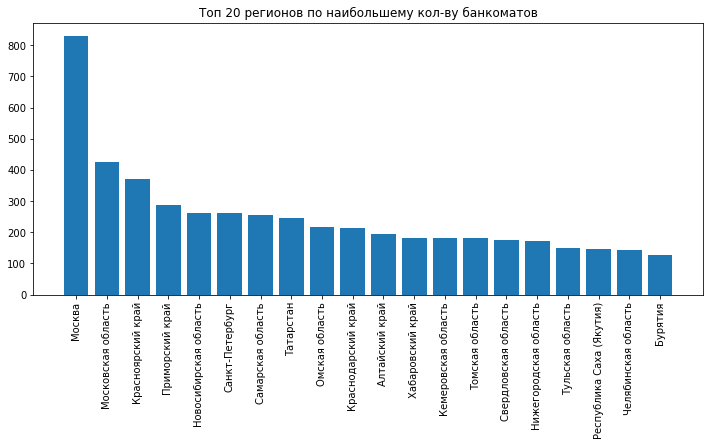

In [111]:
top_reg = data.groupby('name', as_index=False)['id'].nunique().sort_values(by='id', ascending=False)
fig, ax = plt.subplots(figsize=(12, 5))
plt.bar(top_reg.name.head(20),
        top_reg.id.head(20))
plt.xticks(rotation = 90)
plt.title('Топ 20 регионов по наибольшему кол-ву банкоматов')
plt.show()

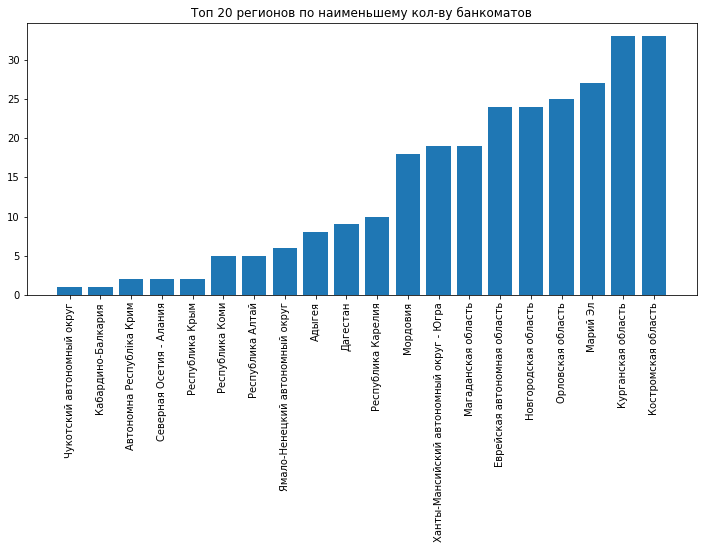

In [112]:
top_reg = data.groupby('name', as_index=False)['id'].nunique().sort_values(by='id')
fig, ax = plt.subplots(figsize=(12, 5))
plt.bar(top_reg.name.head(20),
        top_reg.id.head(20))
plt.xticks(rotation = 90)
plt.title('Топ 20 регионов по наименьшему кол-ву банкоматов')
plt.show()

#### Описательные статистики

In [4]:
# Отбросим технические признаки для статистического анализа
meaningful_subset = set(df.columns).difference(['id', 'lon', 'lat', 'utm',
                                                'geometry', 'address', 'address_rus'])
data[meaningful_subset].describe()

,office_in_500m,target,nearest_food,nearest_college,food_in_500m,nearest_school,nearest_office,hospital_in_500m,nearest_atm,bank_in_500m,nearest_airport,nearest_subway,railway_in_500m,kgarden_in_500m,nearest_railway,nearest_kgarden,nearest_hospital,nearest_neighbour_atm,airport_in_500m,nearest_bank,gov_building_in_500m,college_in_500m,subway_in_500m,nearest_gov_building,nearest_MFC,MFC_in_500m,school_in_500m,atm_in_500m
count,8345.000000,5957.000000,8345.000000,8.343000e+03,8345.000000,8345.000000,8.344000e+03,8345.000000,8345.000000,8345.000000,8.344000e+03,5.503000e+03,8345.000000,8345.000000,8.277000e+03,8345.000000,8345.000000,8.343000e+03,8345.0,8345.000000,8345.000000,8345.000000,8345.000000,8.216000e+03,8.227000e+03,8345.000000,8345.000000,8345.000000
mean,1.435950,0.000735,1678.832764,2.193071e+04,9.799161,5688.955892,7.016913e+03,0.255962,2977.197170,3.557340,9.728368e+04,2.720498e+05,0.208987,0.342600,9.210364e+03,6626.708512,8740.529709,3.043673e+03,0.0,1509.225145,0.024566,0.185740,0.137208,1.323875e+05,7.567107e+04,0.050090,0.258358,4.157819
std,3.977646,0.086220,16236.092250,6.837989e+04,18.394908,24713.467593,3.001673e+04,0.735622,17019.138078,4.332877,1.461575e+05,3.561495e+05,0.557947,0.859044,4.766816e+04,24965.613746,32231.077676,2.293575e+04,0.0,11452.009834,0.229104,0.574726,0.476421,2.160784e+05,1.503609e+05,0.224105,0.628404,5.626723
min,0.000000,-0.145001,0.000000,6.500338e+00,0.000000,8.898374,0.000000e+00,0.000000,0.000000,0.000000,1.252759e+03,3.750273e+00,0.000000,0.000000,3.750273e+00,7.700100,5.767209,0.000000e+00,0.0,0.000000,0.000000,0.000000,0.000000,3.814130e+01,1.192435e+01,0.000000,0.000000,0.000000
25%,0.000000,-0.061486,51.000435,9.005899e+02,1.000000,616.459262,2.954947e+02,0.000000,38.509388,0.000000,2.074395e+04,1.631705e+03,0.000000,0.000000,8.420940e+02,570.820583,679.654073,0.000000e+00,0.0,52.912944,0.000000,0.000000,0.000000,5.303089e+03,1.783565e+03,0.000000,0.000000,0.000000
50%,0.000000,-0.015589,140.540850,2.211891e+03,4.000000,1340.955156,6.415248e+02,0.000000,176.960154,2.000000,4.027727e+04,1.588859e+05,0.000000,0.000000,1.887467e+03,1221.444929,1508.130123,1.520461e+02,0.0,188.131252,0.000000,0.000000,0.000000,3.355997e+04,1.267715e+04,0.000000,0.000000,2.000000
75%,1.000000,0.040243,374.889913,6.323019e+03,10.000000,2989.932606,1.542814e+03,0.000000,545.778690,5.000000,1.135065e+05,3.888044e+05,0.000000,0.000000,3.540879e+03,2905.552493,3455.816242,6.375259e+02,0.0,504.282300,0.000000,0.000000,0.000000,1.890249e+05,1.054536e+05,0.000000,0.000000,6.000000
max,56.000000,0.218608,516692.138186,1.171108e+06,220.000000,587901.021760,1.618190e+06,16.000000,486152.459998,27.000000,1.146987e+06,1.711936e+06,6.000000,11.000000,1.222738e+06,486338.513510,516242.358830,1.290476e+06,0.0,338815.427181,7.000000,10.000000,6.000000,1.620495e+06,1.647623e+06,2.000000,7.000000,59.000000


#### Пропуски

In [5]:
def missing_values_table(df):
    
        '''
        Считает пропуски и % пропусков в df
        '''
        
        # Всего пропусков
        mis_val = df.isna().sum()
        
        # Процент пропусков
        mis_val_percent = 100 * df.isna().sum() / len(df)

        # Таблица с результатами
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        # Переименовываем колонки
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Пропущенных значений', 1 : '% от общего количества значений'})
        
        # Сортируем по убыванию % пропуска
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% от общего количества значений', ascending=False).round(1)
        
        # Выводим информацию
        print ("В таблице " + str(df.shape[1]) + " колонок.\n"   
           + str(mis_val_table_ren_columns.shape[0]) +
              " колонок имеют пропущенные значения.")
        
        return mis_val_table_ren_columns

In [6]:
missing_values_table(data)

В таблице 36 колонок.
9 колонок имеют пропущенные значения.


,Пропущенных значений,% от общего количества значений
nearest_subway,2842,34.1
target,2388,28.6
nearest_gov_building,129,1.5
nearest_MFC,118,1.4
nearest_railway,68,0.8
nearest_college,2,0.0
nearest_neighbour_atm,2,0.0
nearest_office,1,0.0
nearest_airport,1,0.0


* Пропуски в колонке **target** сигнализируют о том, что это тестовый срез, заменять ничем не нужно
* Пропуски в **neares_*** – при обогащении данных мы разделяли исходный набор данных по UTM зонам и высчитывали признаки внутри каждой из них. Из за этого, некоторые признаки отржающие удаленность от объектов инфраструктуры оказались пусты, тк объекта данного типо могло не оказаться в зоне. В общем случае данные пропуски нужно заменить на большую константу (например - максимум из всех расстояний). Но если вдаваться в детали, то NaN могли получится на границах UTM зон. Например, в случае Санкт-Петербурга, где в части Лен. Области нет данных о близости метро, хотя до метро не так уж и далеко. Такие случае желательно обработать отдельно (мб совместить соседние UTM зоны).

Так же, стоит заметить, что в изначальном датасете отсутствуют данные о геграфическом положении некотрых банкоматов. Этот пробел можно заполнить геокодингом по адресу. (to-do)

#### Взаимосвязи признаков

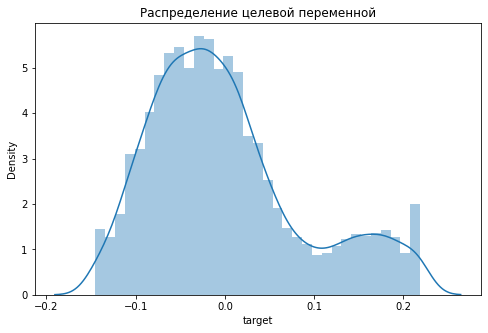

In [22]:
fig, ax = plt.subplots(figsize=(8, 5))
sns.distplot(data['target'], ax=ax)
plt.title('Распределение целевой переменной')
plt.show()

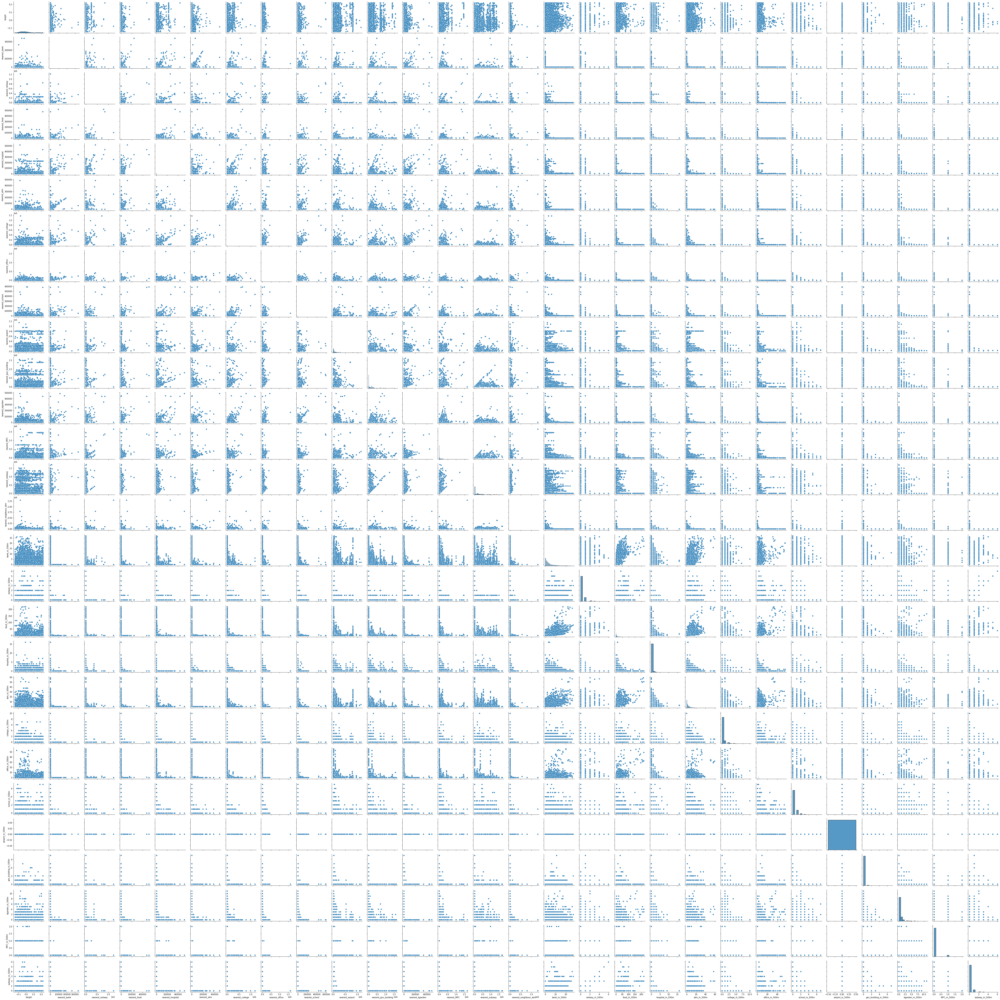

In [8]:
# pp = sns.pairplot(data[meaningful_subset]) # оч долго рисует график
# pp.savefig('parplot.png')
Image(filename='pairplot.png')

Сразу бросается в глаза `airport_in_500m`, у колонки одно единственное значение - 0. Данный признак не несет в себе никакой информации, минимальная дистанция между банкоматами в нашем наборе данных и аэропортами 1250м.

In [9]:
data['nearest_airport'].min()

1252.7587202440866

In [10]:
# Удаляем признак
data.drop('airport_in_500m', axis=1, inplace=True)
meaningful_subset.remove('airport_in_500m')

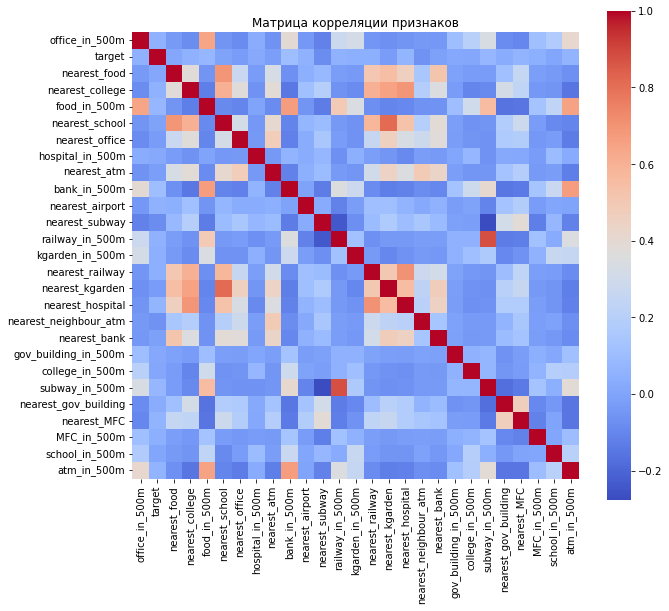

In [107]:
# Матрица корреляций
f, ax = plt.subplots(figsize=(10, 9))
corr = data[meaningful_subset].corr()

sns.heatmap(corr, cmap='coolwarm', square=True, ax=ax)
plt.title('Матрица корреляции признаков')
plt.show()

Из графика видно, что линейной зависимости между `target` и остальными признаками практически нет.

Так же можно уловить несколько других инетерсных моментов:
* Удаленность от школы достаточно сильно коррелирует с удаленностью от детского сада -> эти типы объектов часто находятся рядом друг с другом.
* Школы и места общественного питания часто расположены недалеко друг от друга.
* Места общественного питания обычно расположены вблизи банков.